## 2D Discrete Fourier Transform

General form for NxN image:
* Forward DFT
$$
\begin{align}
F(u,v) = \sum_{x=0}^{N-1}\sum_{y=0}^{N-1}f(x,y) e^{(-j2\pi\frac{ux + vy}{N})} \; where \; u, v=0,1,2,...N-1
\end{align}
$$

* Inverse DFT
$$
\begin{align}
f(x,y) = \frac{1}{N^2} \sum_{u=0}^{N-1}\sum_{v=0}^{N-1}F(u,v) e^{(+j2\pi\frac{ux+vy}{N})} \; where \; x,y=0,1,2,...N-1
\end{align}
$$


In [19]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import PIL.Image as Image 
import math
import os
import cmath
import time
import csv
import cv2
import torch
import medpy as mp
import medpy.io.load as mp_load
import medpy.io.save as mp_save

### 2D basis function

In [88]:
n = 32
m = 32
arr = np.zeros((n, m))
u = 1
v = -1
for i in range(n):
    for j in range(m):
        arr[i][j] = np.cos(2 * math.pi * (u*i + v*j)/n)

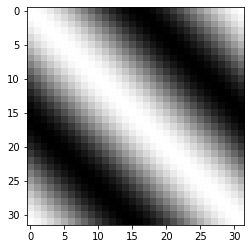

In [89]:
plt.imshow(arr, cmap='gray')

## 2D dft, naive implementation

In [93]:
def _2d_dft(img, N, M):
    F = np.zeros((N, M), dtype=np.complex128)
    for kx in range(N):
        for ky in range(M):
            res = 0 + 0j
            for i in range(N):
                for j in range(M):
                    res += img[i, j] * (np.cos(2*math.pi*(kx*i + ky*j)/N) - 1j*np.sin(2*math.pi*(kx*i + ky*j)/N))
            F[kx, ky] = res
    return F

In [94]:
res_dft = _2d_dft(arr, 32, 32)
res_dft = np.fft.fftshift(res_dft)

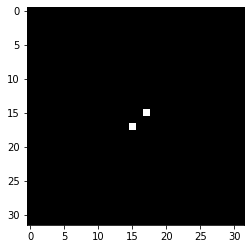

In [95]:
plt.imshow(np.real(res_dft), cmap='gray')

In [96]:
def _2d_idft(freq, N, M):
    arr = np.zeros((N, M), dtype=np.complex128)
    for i in range(N):
        for j in range(M):
            res = 0 + 0j
            for kx in range(N):
                for ky in range(M):
                    res += freq[kx, ky] * (np.cos(2*math.pi*(kx*i + ky*j)/N) + 1j*np.sin(2*math.pi*(kx*i + ky*j)/N))
            arr[i, j] = res
    arr = 1/(N*N) * arr
    return arr

In [97]:
res_idft = np.fft.ifftshift(res_dft)
res_idft = _2d_idft(res_idft, 32, 32)

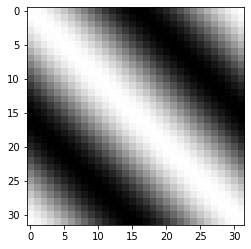

In [98]:
#recover image using inverse DFT
plt.imshow(np.real(res_idft), cmap='gray')

## 2D DFT example pairs for an t1/t2 sequence

In [6]:
imgs = {}
for file in os.listdir('.'):
    if file.endswith('.png'):
        imgs[file.split('.')[0].split('_')[-1]] = cv2.imread(file, 0)

In [7]:
def fourier(img):
    dft = np.fft.fft2(np.float32(img))
    dft_shift = np.fft.fftshift(dft)
    mag = np.abs(dft_shift)
    ang = np.angle(dft_shift)
    return mag, ang

def inverse_fourier(mag, ang):
    combined = np.multiply(mag, np.exp(1j*ang))
    fftx = np.fft.ifftshift(combined)
    ffty = np.fft.ifft2(combined)
    imgCombined = np.abs(ffty)
    return imgCombined

def adjust_magnitude(mag):
    mx = np.amax(np.log(mag+0.001))
    return np.uint8(1*(mag/mx))

In [8]:
# compute 2D dft
dft_data_dict = {}
for seq, img in imgs.items():
    mag, ang = fourier(img)
    mag_for_plot = adjust_magnitude(mag)
    dft_data_dict[seq] = {'image': img, 'mag': mag_for_plot, 'ang': ang}

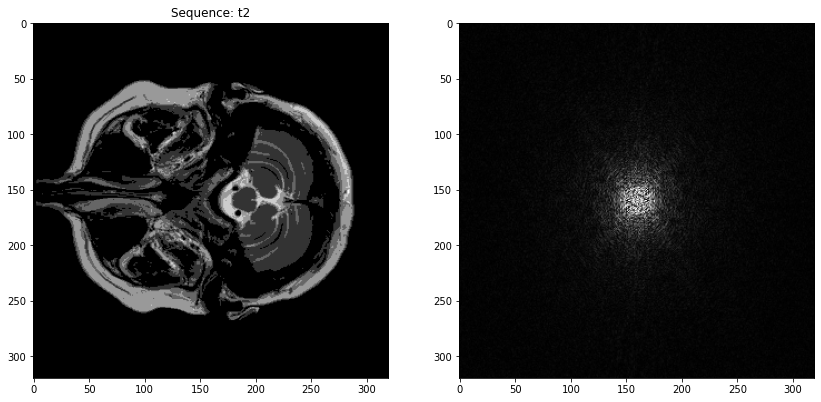

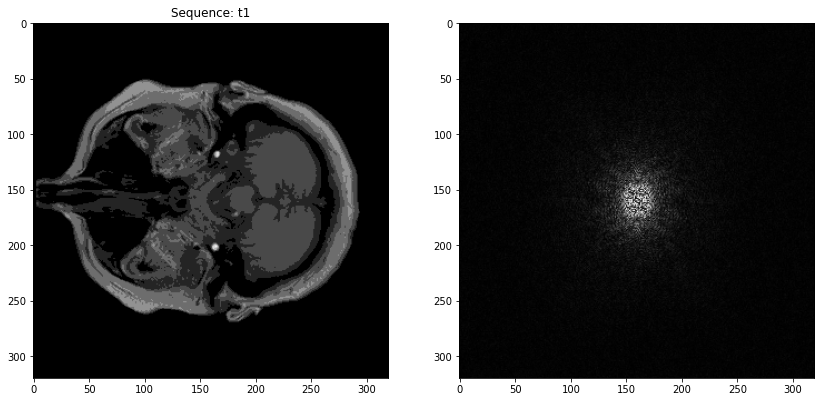

In [9]:
for seq, dict_ in dft_data_dict.items():
    _, ax = plt.subplots(1, 2, figsize=(14,14))
    ax[0].set_title('Sequence: ' + str(seq))
    ax[0].imshow(dict_['image'], cmap='gray')
    ax[1].imshow(dict_['mag'], cmap='gray')
    #ax[2].imshow(dict_['ang'], cmap='gray')

### Sampling mechanisms to understand frequency and spatial domains

1. Circular mask with center of circle at center of image. Control param: radius
2. Random mask. Control param: number of points
3. Line mask. Control param: number of lines, vertical/horizontal

Different masks created to observe how it affects reconstruction of original image using the inverse Discrete Fourier Transform

In [30]:
def generate_masks_lines(N, axis=0):
    masks = [np.zeros(shape=(N, N), dtype=np.float32)]
    num_points = [0]
    mask_num_points_pair = [{'mask': masks[0], 'num_points':num_points[0]}]
    for step_size in range(1, N//8, 1):
        mask = np.ones(shape=(N, N), dtype=np.float32)
        cnt = 0
        for j in range(1, N):
            if j%step_size == 0 and axis == 1:
                mask[:, j] = 0
                cnt += 1
            if j%step_size == 0 and axis == 0:
                mask[j, :] = 0
                cnt += 1
        mask_num_points_pair.append({
            'mask': mask,
            'num_points': N**2 - cnt * N 
        })
    return mask_num_points_pair
        

In [31]:
vertical_mask = generate_masks_lines(320, axis=1)
horizontal_mask = generate_masks_lines(320, axis=0)

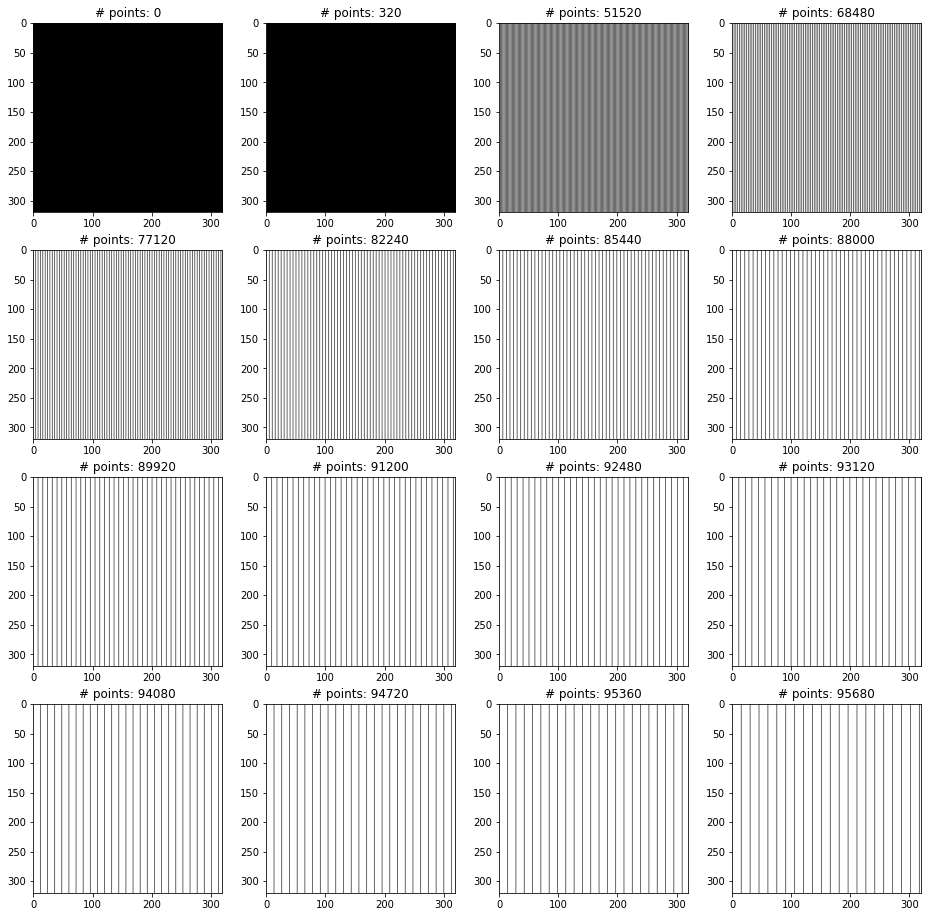

In [32]:
_, ax = plt.subplots(4,4, figsize=(16, 16))
ax = ax.flatten()
for m, ax in zip(vertical_mask, ax):
    ax.imshow(m['mask'], cmap='gray')
    ax.set_title('# points: ' + str(m['num_points']))
plt.show()

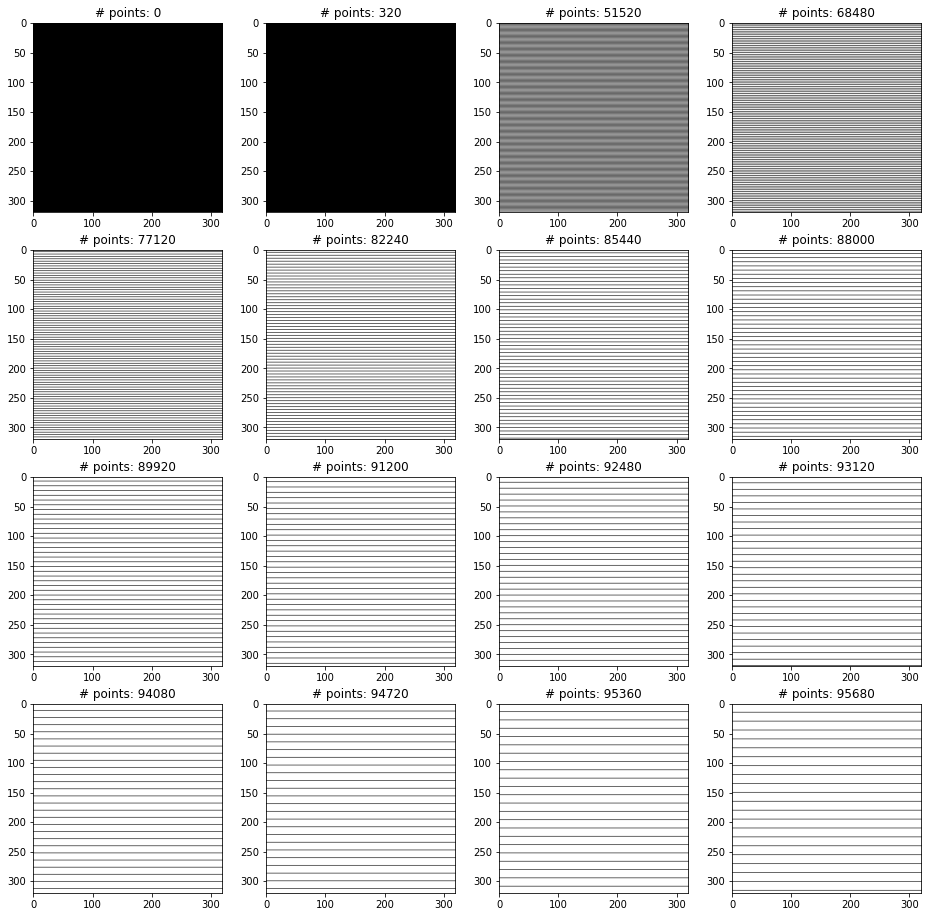

In [33]:
_, ax = plt.subplots(4,4, figsize=(16, 16))
ax = ax.flatten()
for m, ax in zip(horizontal_mask, ax):
    ax.imshow(m['mask'], cmap='gray')
    ax.set_title('# points: ' + str(m['num_points']))
plt.show()

In [34]:
def generate_masks_decreasing_mag(N):
    masks = [np.zeros(shape=(N, N), dtype=np.float32)]
    num_points = [0]
    mask_num_points_pair = [{'mask': masks[0], 'num_points':num_points[0]}]
    center = (N//2, N//2)
    for radius in range(1, N//2 + 1, 10):
        Y, X = np.ogrid[:N, :N]
        dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)
        mask = dist_from_center <= radius
        counts = dict(zip(*np.unique(mask.astype('int'), return_counts=True)))
        mask_num_points_pair.append({
            'mask': mask.astype('float'),
            'num_points': counts[1]
        })
    return mask_num_points_pair

In [35]:
circular_mask = generate_masks_decreasing_mag(320)

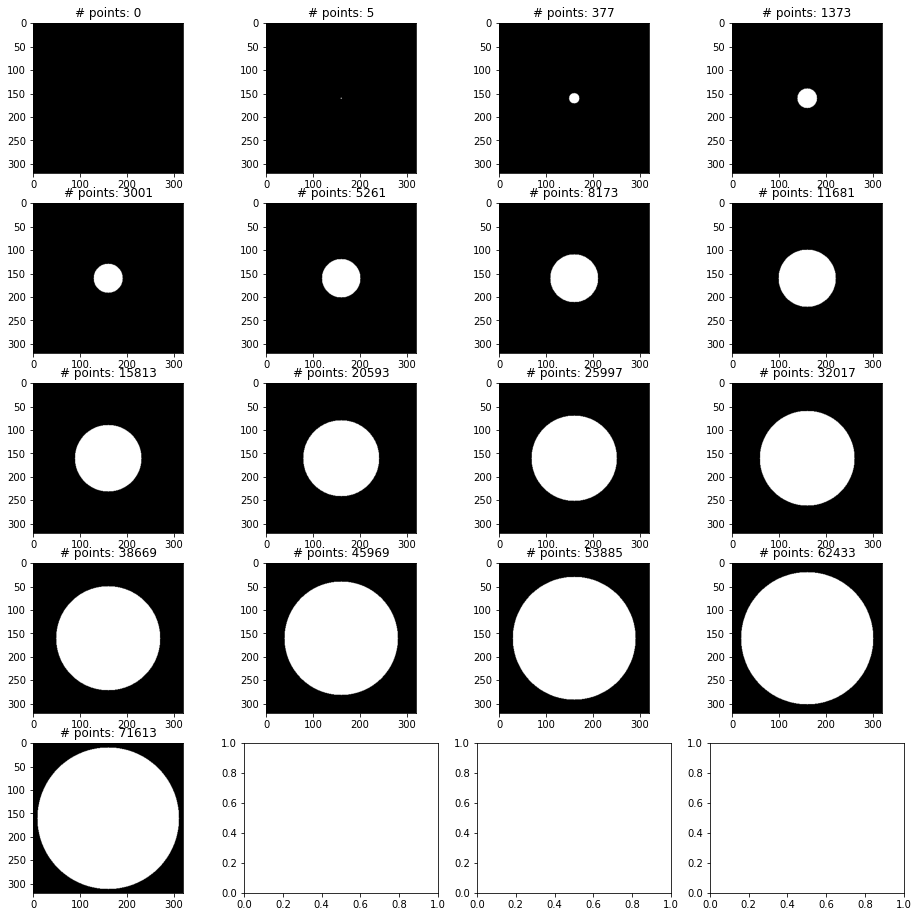

In [36]:
_, ax = plt.subplots(5,4, figsize=(16, 16))
ax = ax.flatten()
for m, ax in zip(circular_mask, ax):
    ax.imshow(m['mask'], cmap='gray')
    ax.set_title('# points: ' + str(m['num_points']))
plt.show()

In [37]:
def generate_masks_random(N):
    masks = [np.zeros(shape=(N, N), dtype=np.float32)]
    num_points = [0]
    mask_num_points_pair = [{'mask': masks[0], 'num_points':num_points[0]}]
    i = 1
    while i:
        temp = 2**i
        sample_size = (temp - 2**(i-1))
        if (temp <= N**2) and ((temp + 2*sample_size) <= N**2):
            mask_intermediate = masks[i-1].copy()
            temp_pair = {}
            us = [j*np.random.choice([-1, 1]) for j in np.random.randint(0, N//2, sample_size)]
            vs = [j*np.random.choice([-1, 1]) for j in np.random.randint(0, N//2, sample_size)]
            for j in range(len(us)):
                mask_intermediate[N//2 + us[j], N//2 + vs[j]] = 1
                mask_intermediate[N//2 - us[j], N//2 - vs[j]] = 1
            masks.append(mask_intermediate)
            num_points.append(num_points[i-1] + 2*sample_size)
            temp_pair['mask'] = mask_intermediate
            temp_pair['num_points'] = num_points[i-1] + 2*sample_size
            mask_num_points_pair.append(temp_pair)
            #print(temp, sample_size, num_points)
            i += 1
        else:
            i = 0
            break
            
    masks.append(np.ones(shape=(N, N), dtype=np.float32)) #empty mask
    mask_num_points_pair.append({
        'mask': np.ones(shape=(N, N), dtype=np.float32),
        'num_points': N**2
    })
    return mask_num_points_pair

In [38]:
random_mask = generate_masks_random(320)

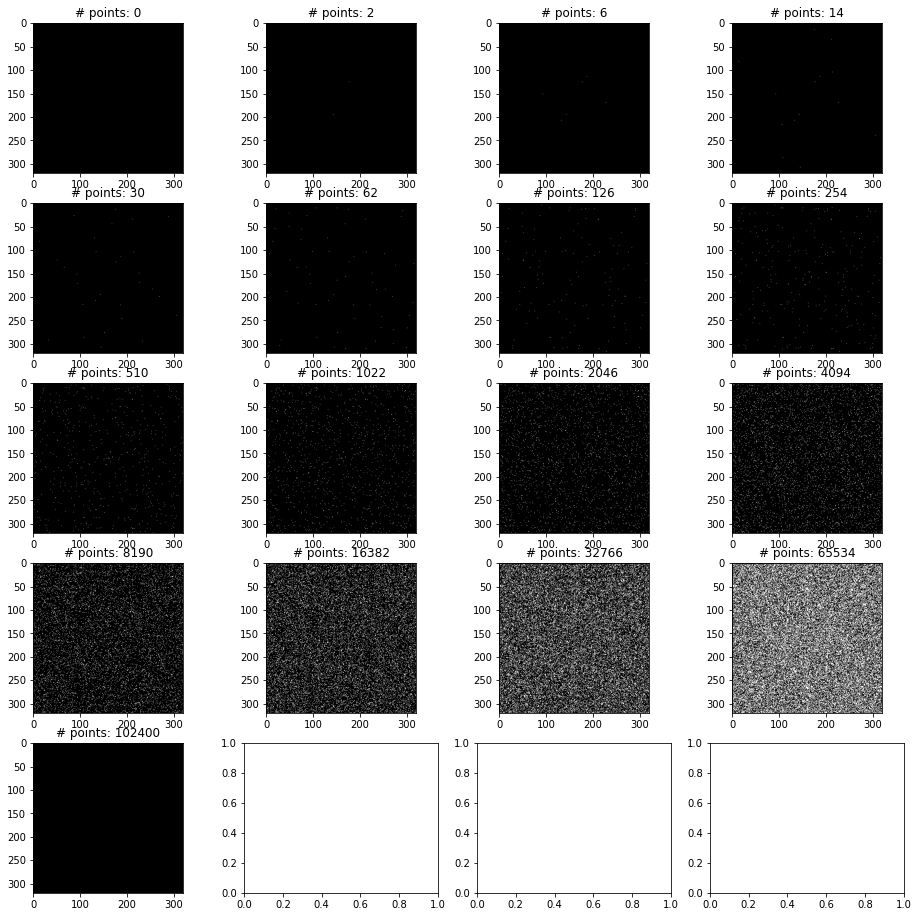

In [39]:
_, ax = plt.subplots(5,4, figsize=(16, 16))
ax = ax.flatten()
for m, ax in zip(random_mask, ax):
    ax.imshow(m['mask'], cmap='gray')
    ax.set_title('# points: ' + str(m['num_points']))
plt.show()

In [42]:
def get_plots_inverse_ft(dft_mag, dft_ang, mask_list, output_dir):
    res = []
    mag_masks = []
    idft_res = []
    for pair in mask_list:
        temp = {}
        mag_masked = mag * pair['mask']
        temp['mag'] = mag
        temp['mag_mask'] = mag_masked
        temp['idft'] = inverse_fourier(mag_masked, ang)
        temp['num_points'] = pair['num_points']
        res.append(temp)
    
    for dict_ in res:
        _, ax = plt.subplots(1, 2, figsize=(16, 16))
        mx = np.amax(np.log(dict_['mag_mask']+0.001))
        mask_final = np.uint8(1*(dict_['mag_mask']/mx))
        ax[0].imshow(mask_final, cmap='gray')
        ax[0].set_title('# points: ' + str(dict_['num_points']))
        ax[1].imshow(dict_['idft'], cmap='gray')
        plt.savefig(os.path.join(output_dir, 'num_points_'+ str(dict_['num_points']) + '.png'))

## t1

In [206]:
t1_dict = dft_data_dict['t1']

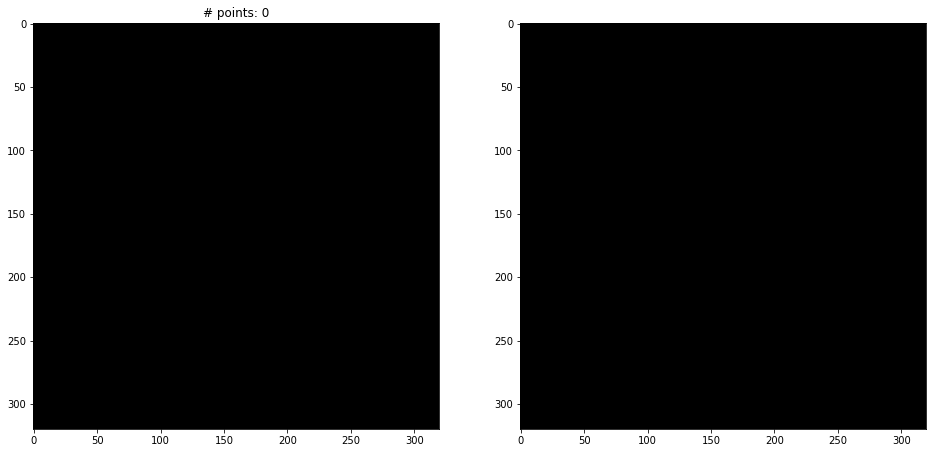

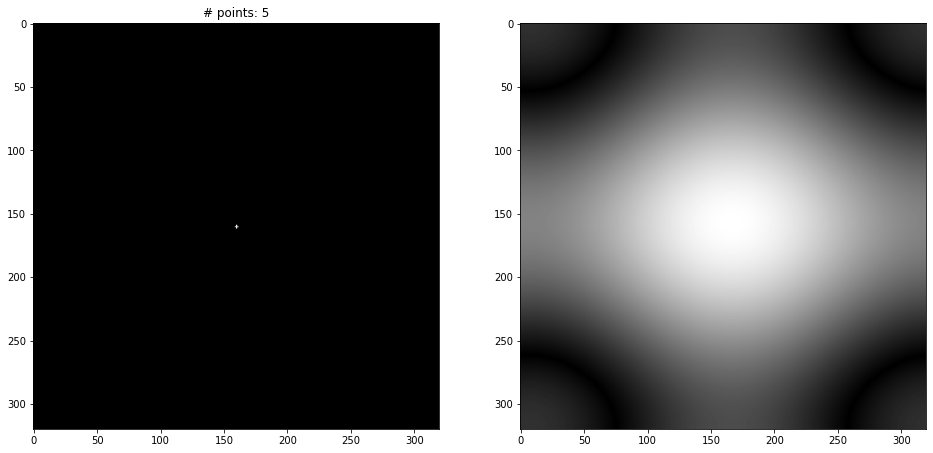

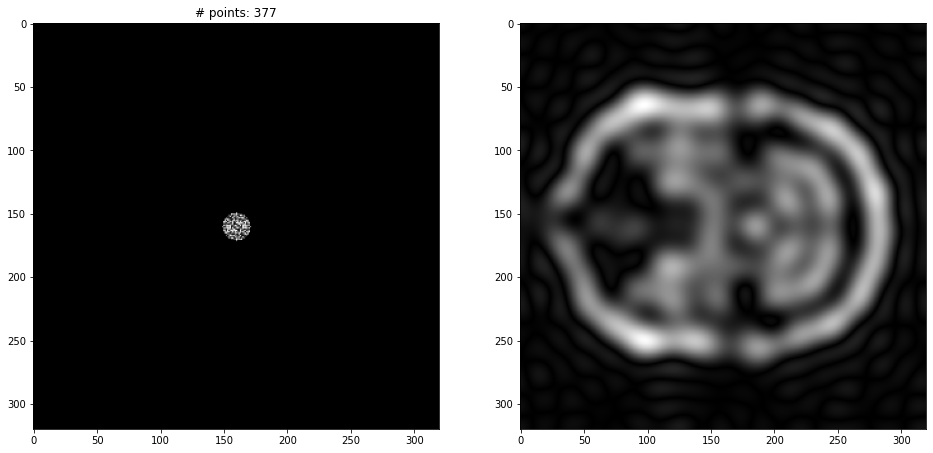

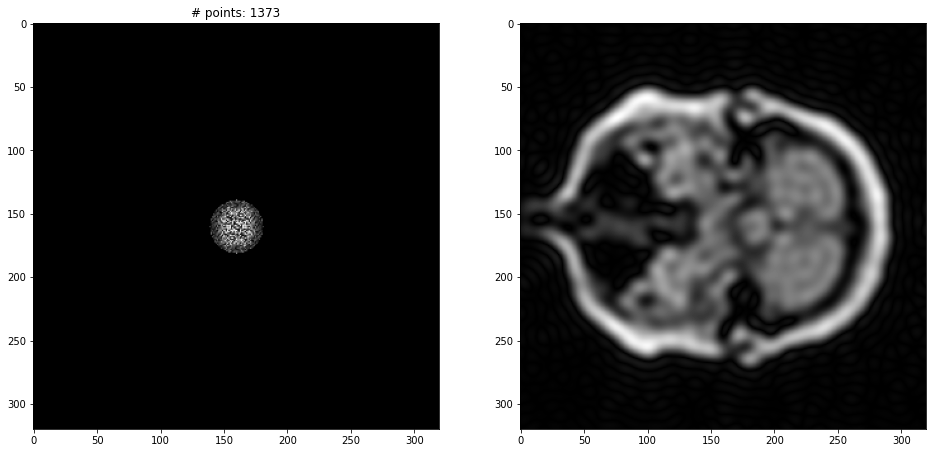

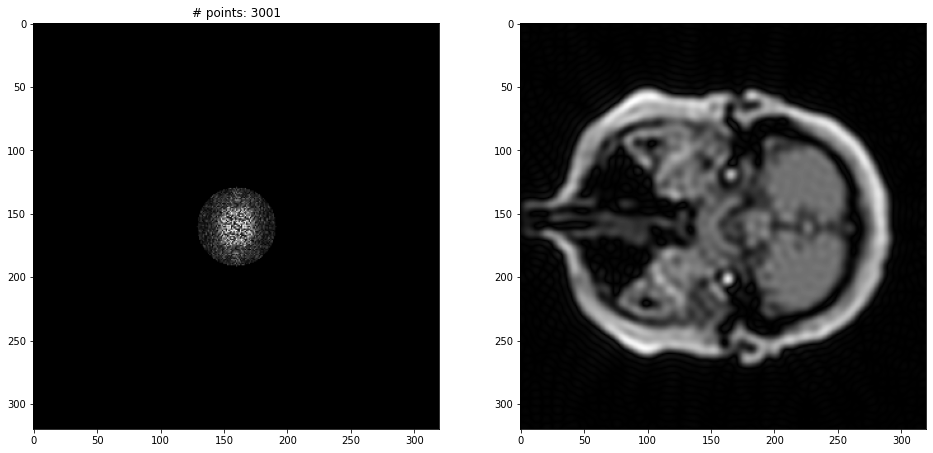

...

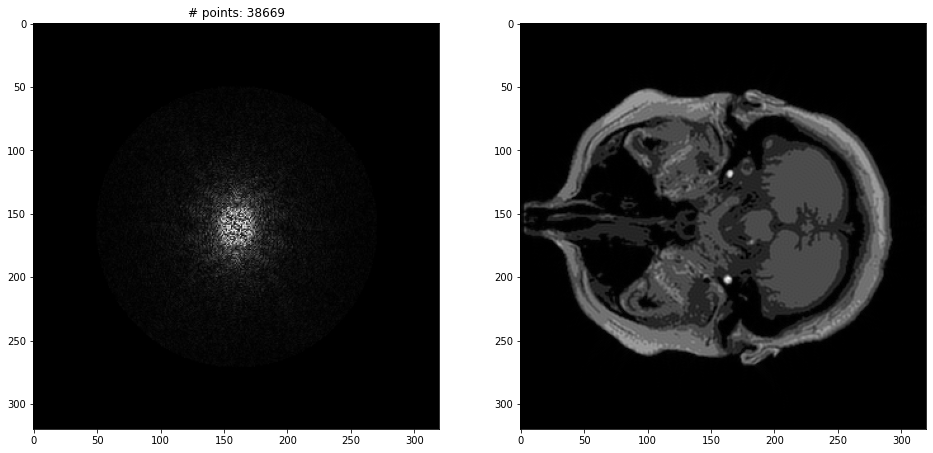

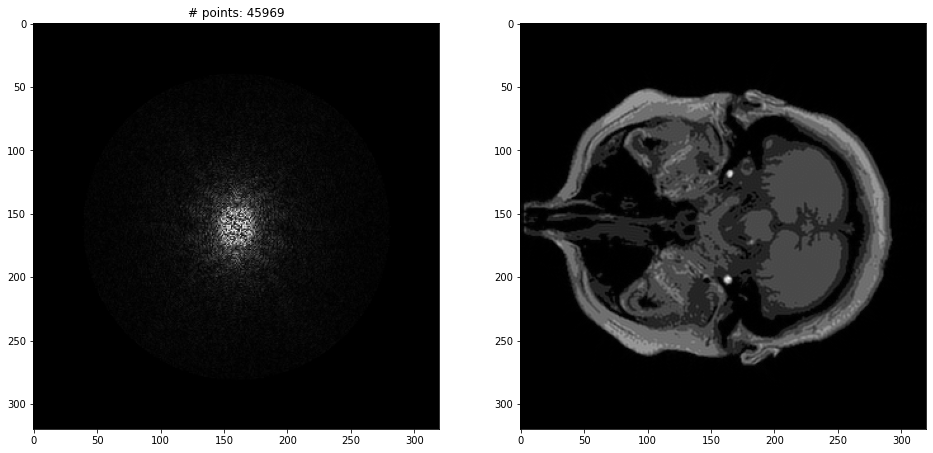

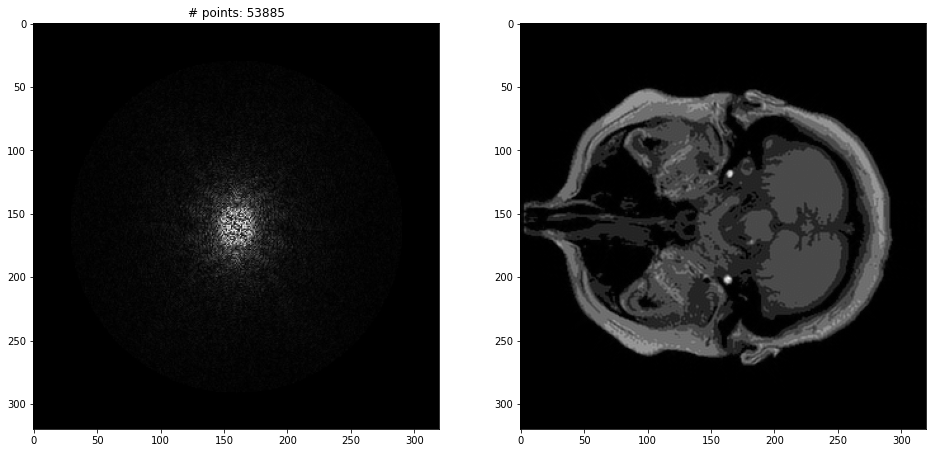

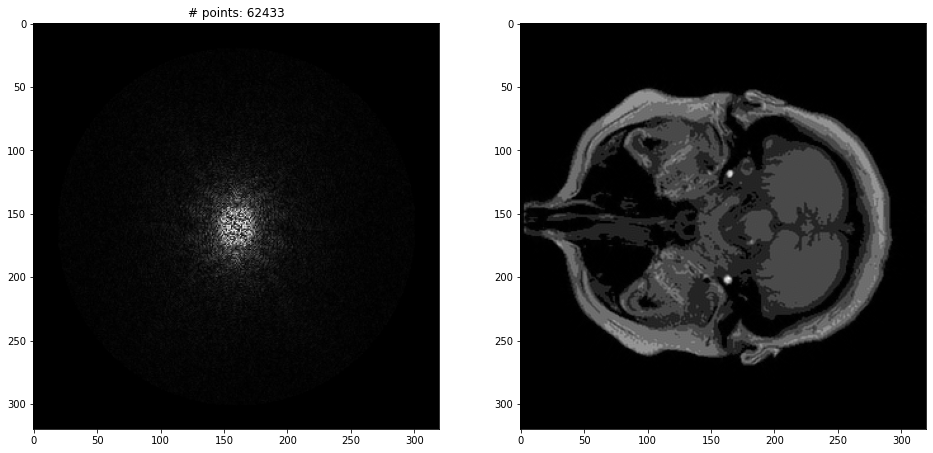

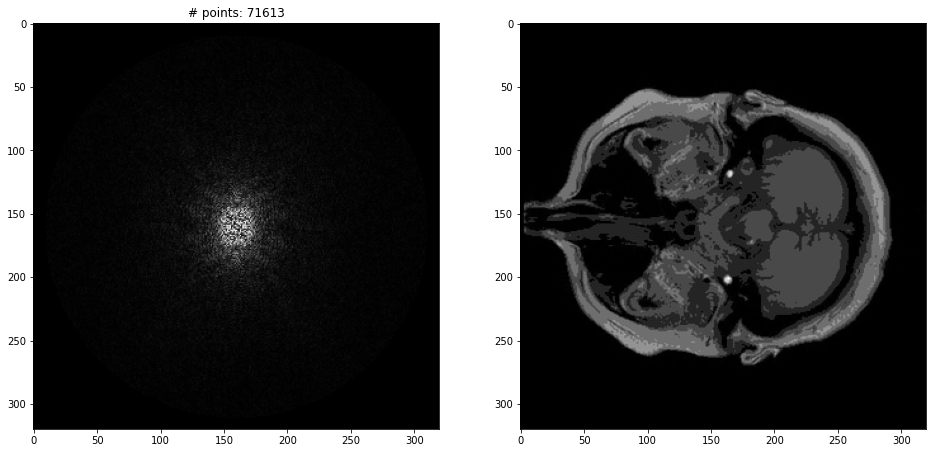

In [231]:
get_plots_inverse_ft(t1_dict['mag'], t1_dict['ang'], circular_mask, 'circular_mask_idft_pairs')

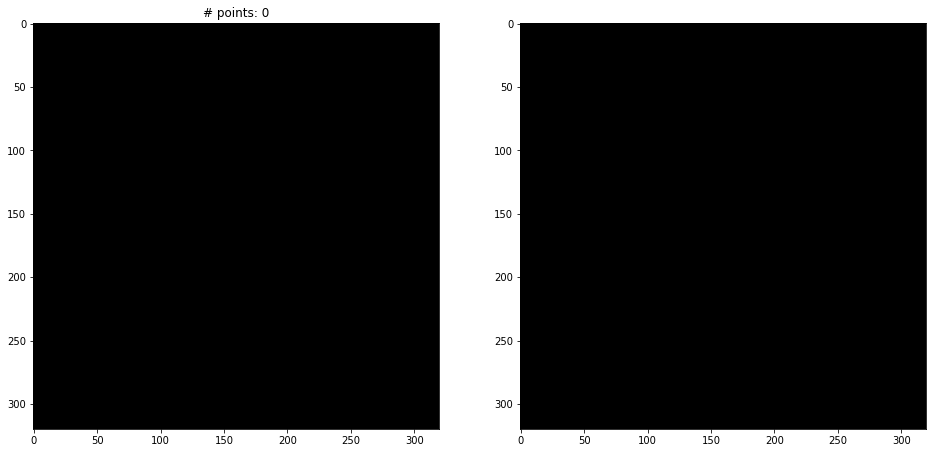

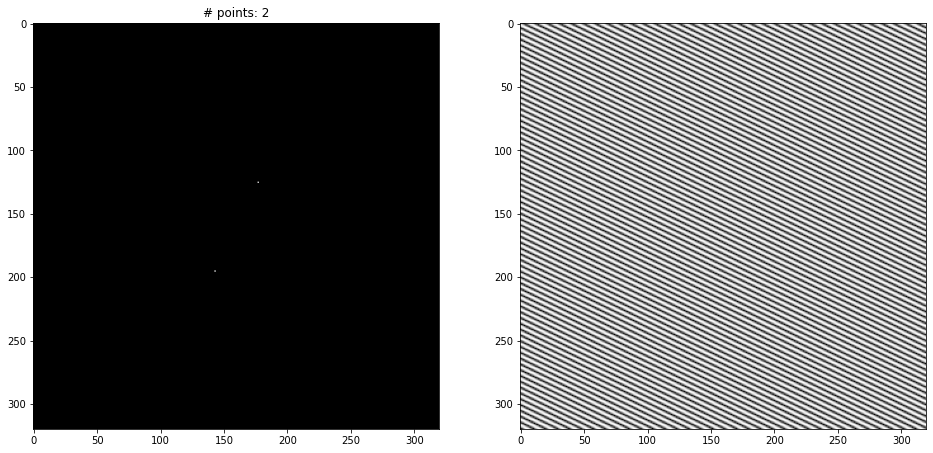

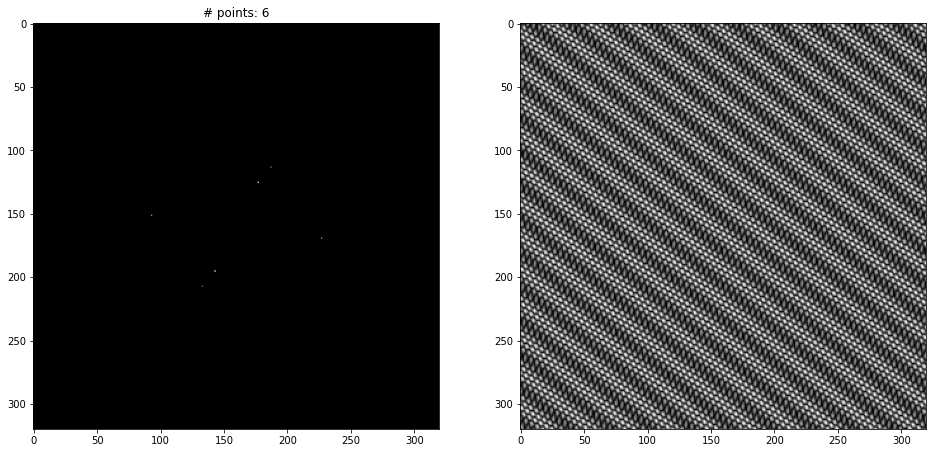

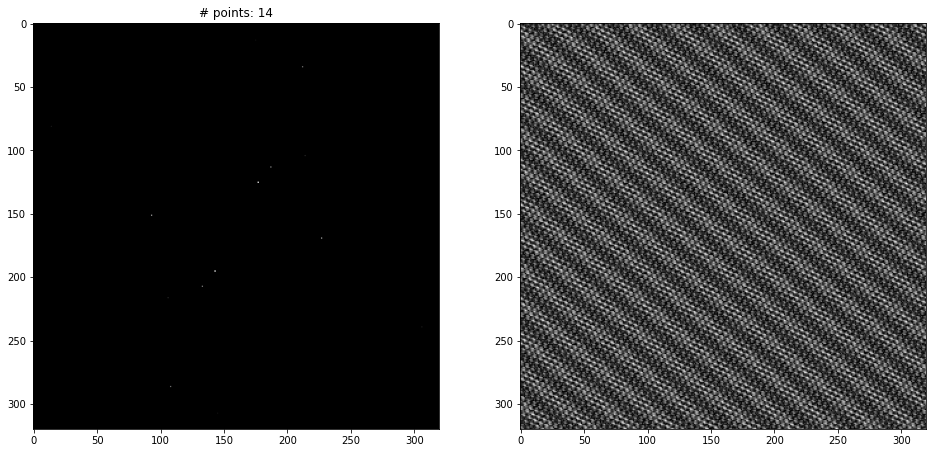

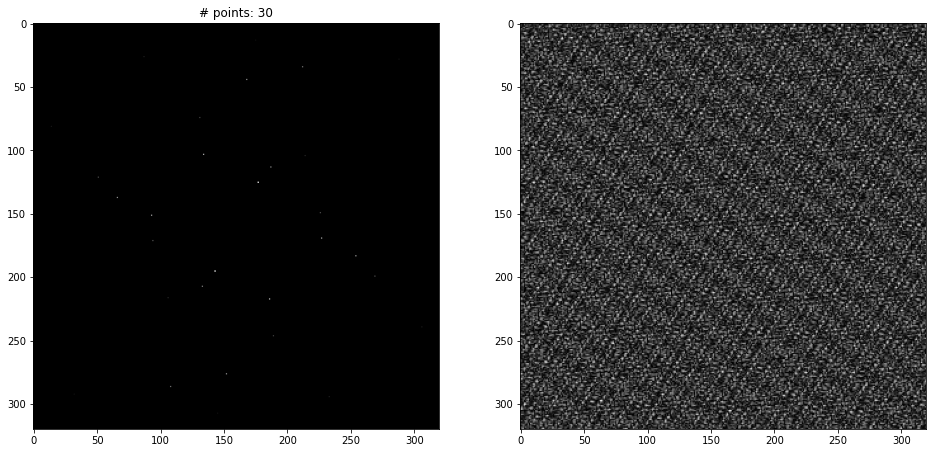

...

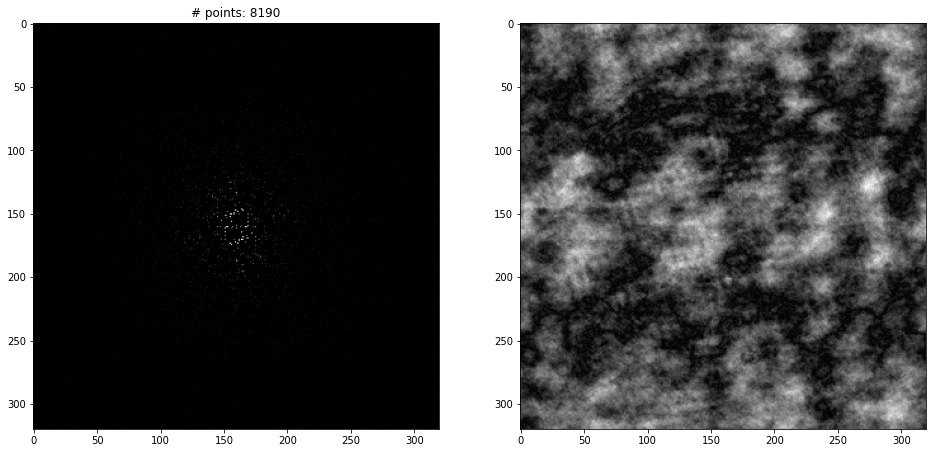

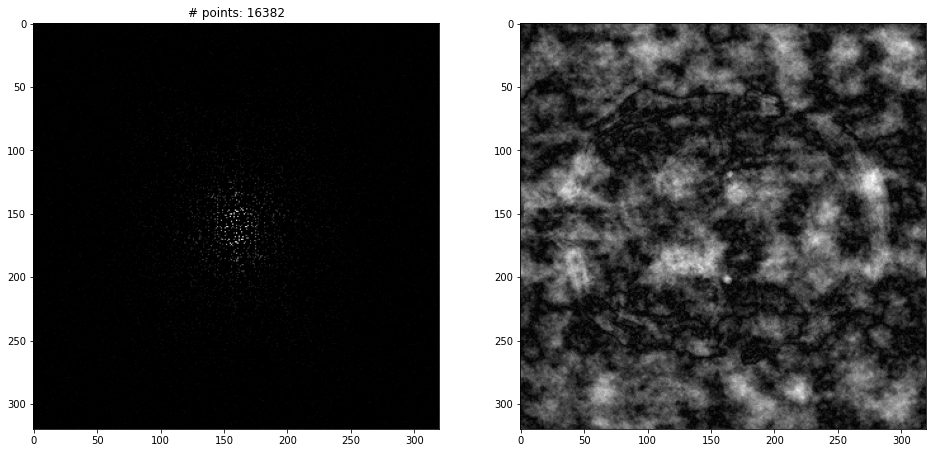

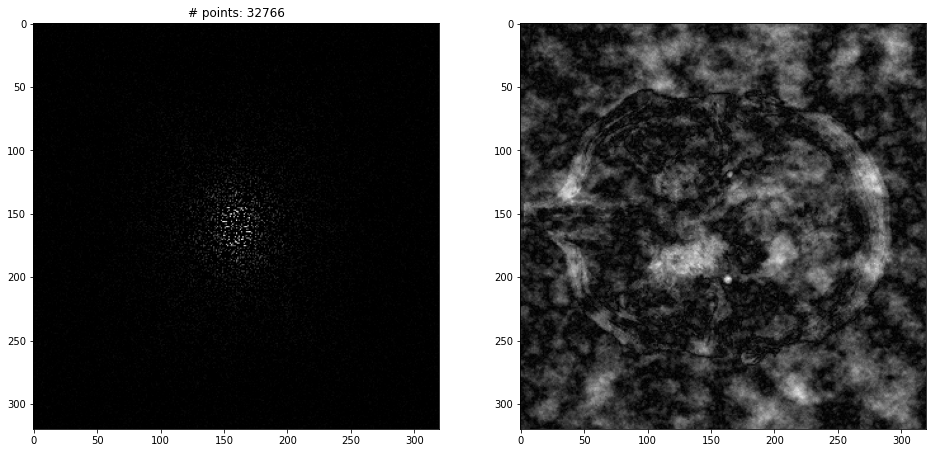

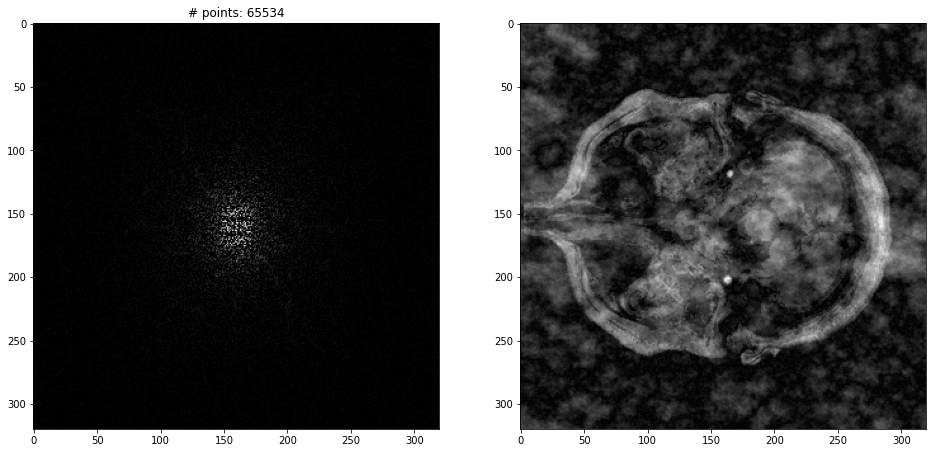

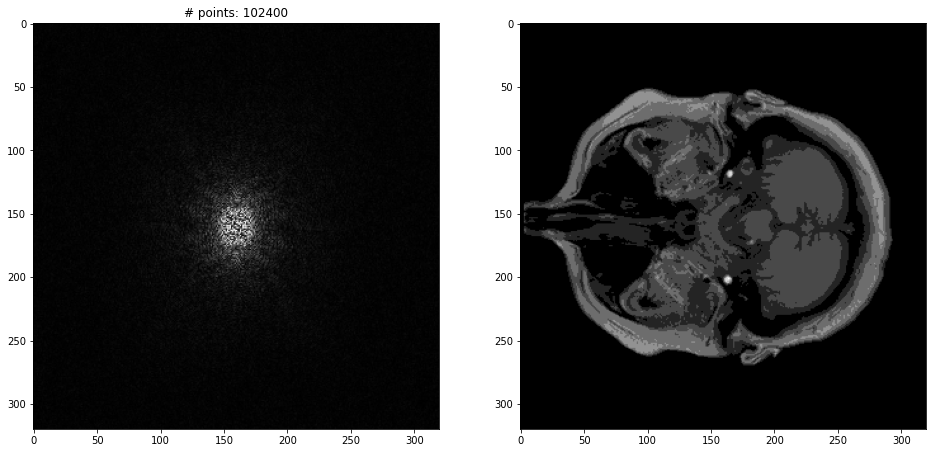

In [232]:
get_plots_inverse_ft(t1_dict['mag'], t1_dict['ang'], random_mask, 'random_mask_idft_pairs')

<ipython-input-42-f10dbabd32ea>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(1, 2, figsize=(16, 16))


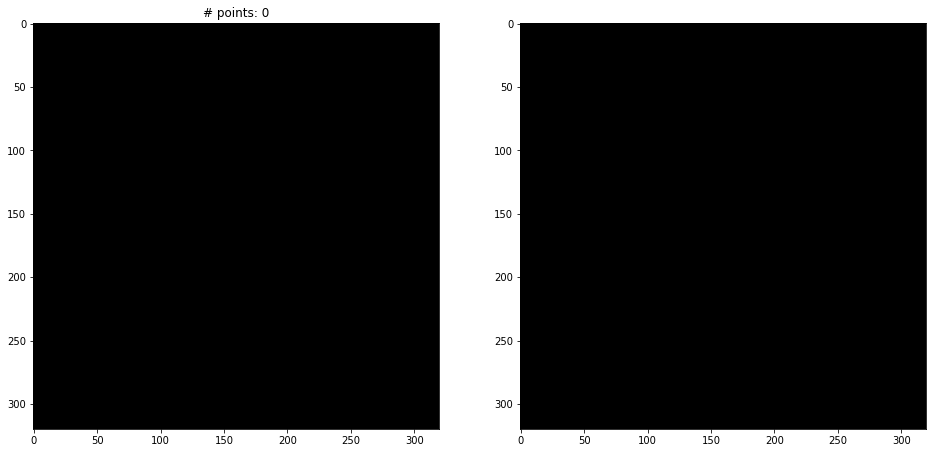

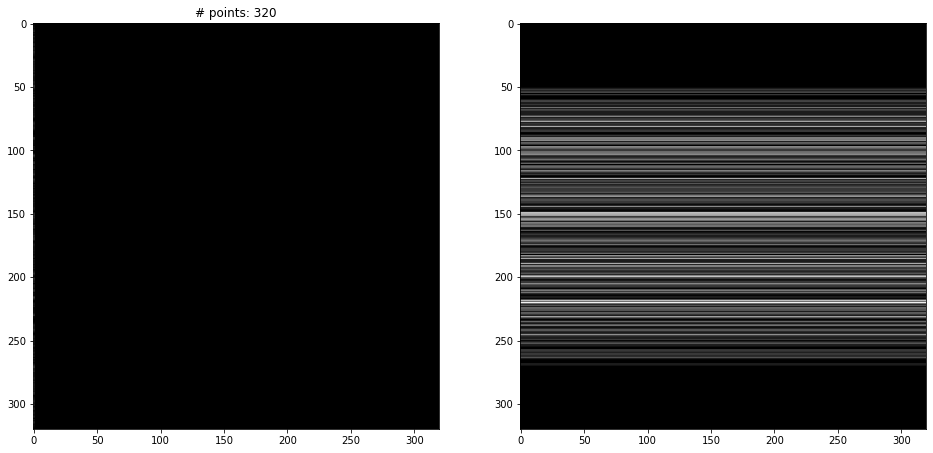

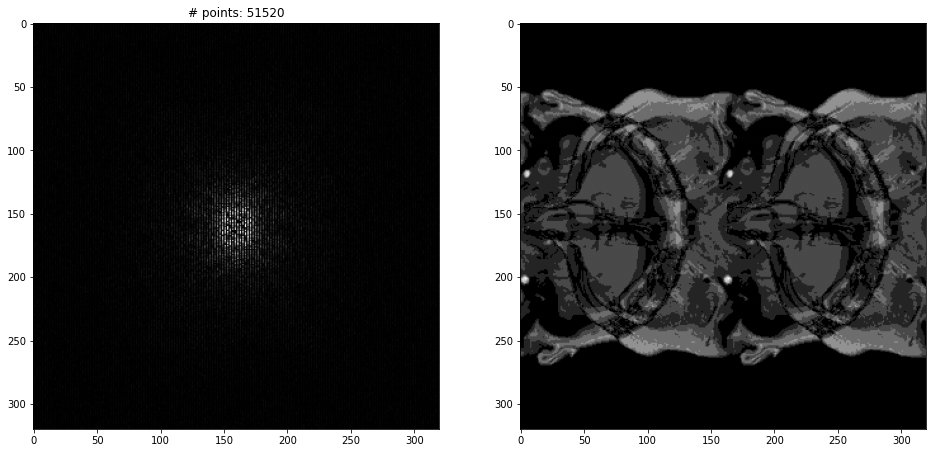

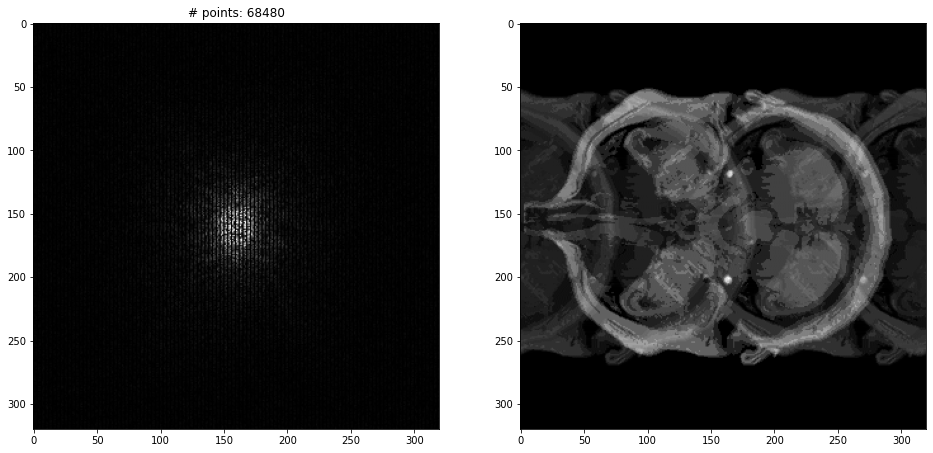

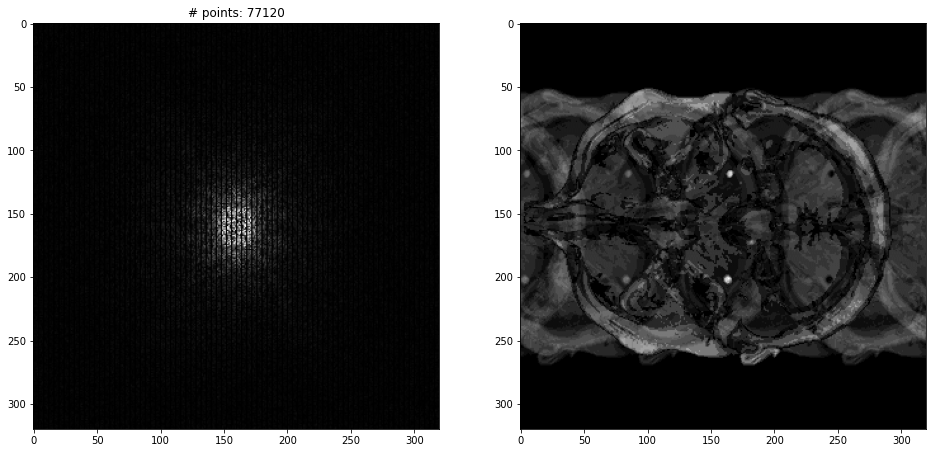

...

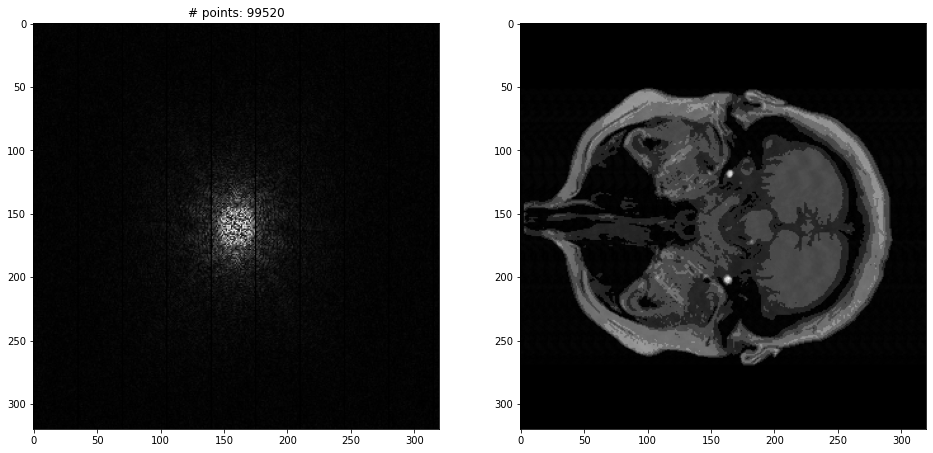

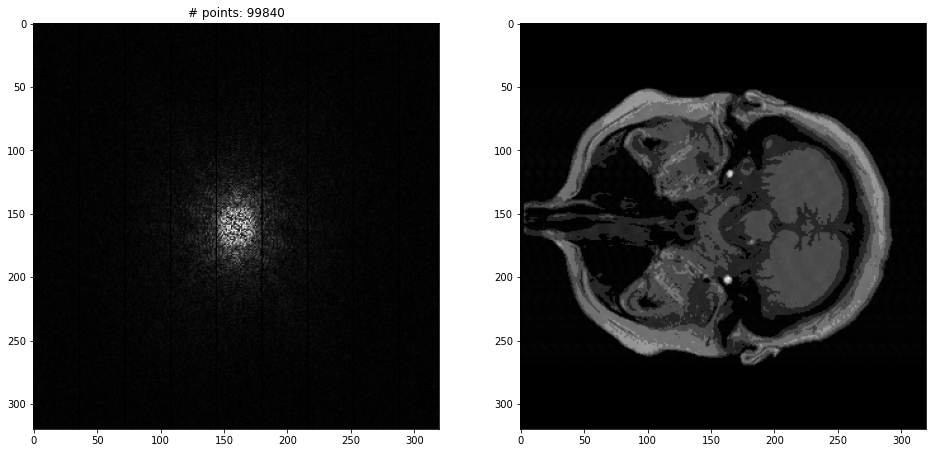

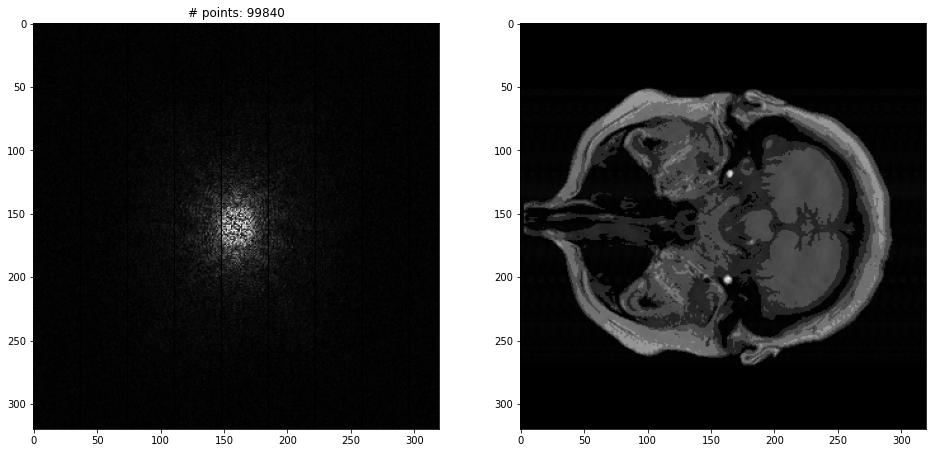

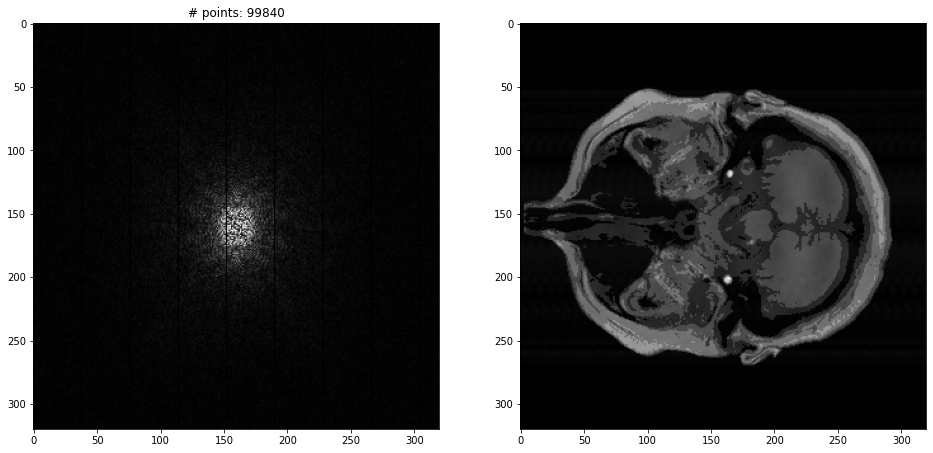

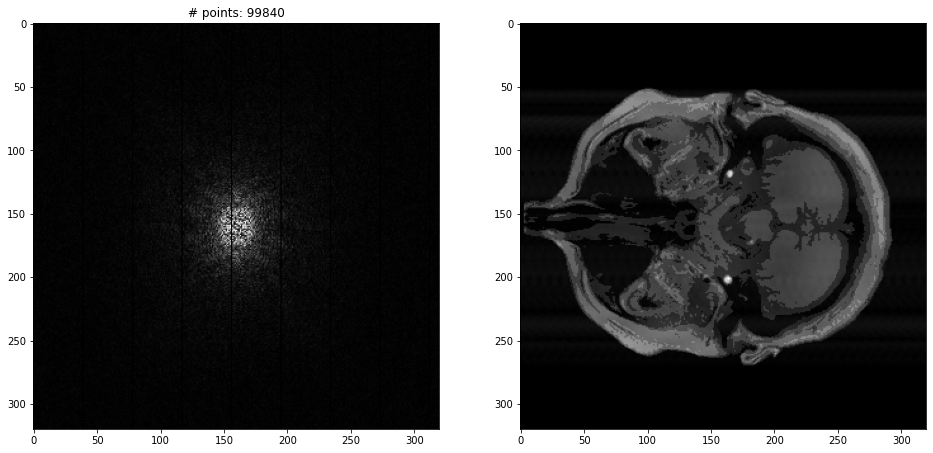

In [233]:
get_plots_inverse_ft(t1_dict['mag'], t1_dict['ang'], vertical_mask, 'vertical_mask_idft_pairs')

<ipython-input-42-f10dbabd32ea>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(1, 2, figsize=(16, 16))


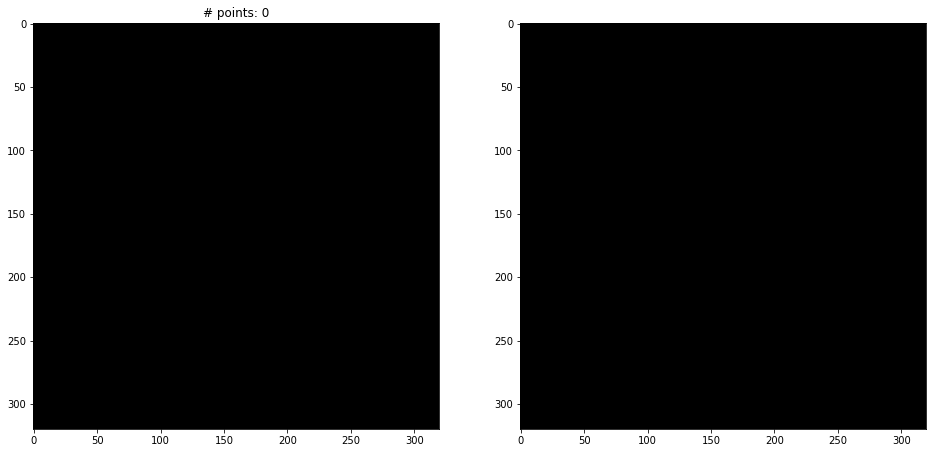

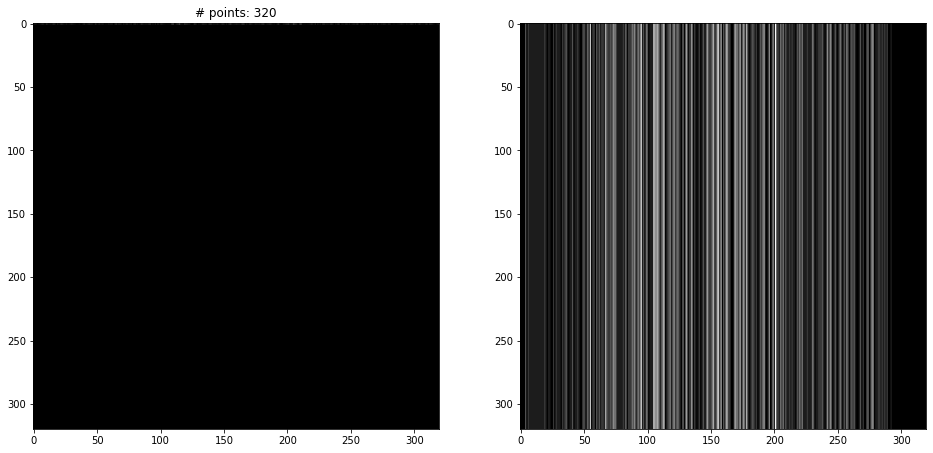

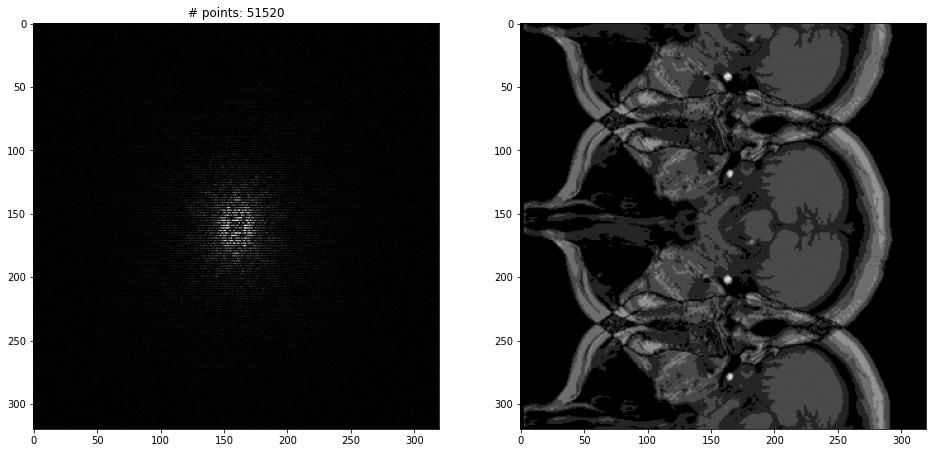

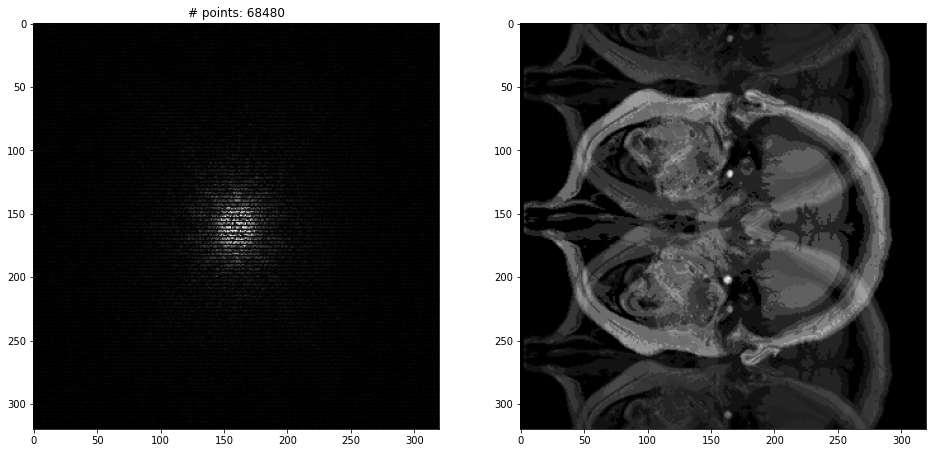

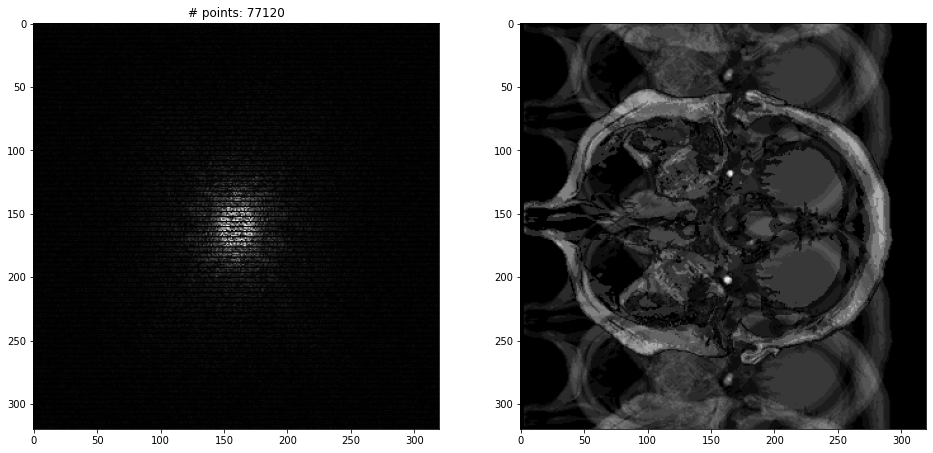

...

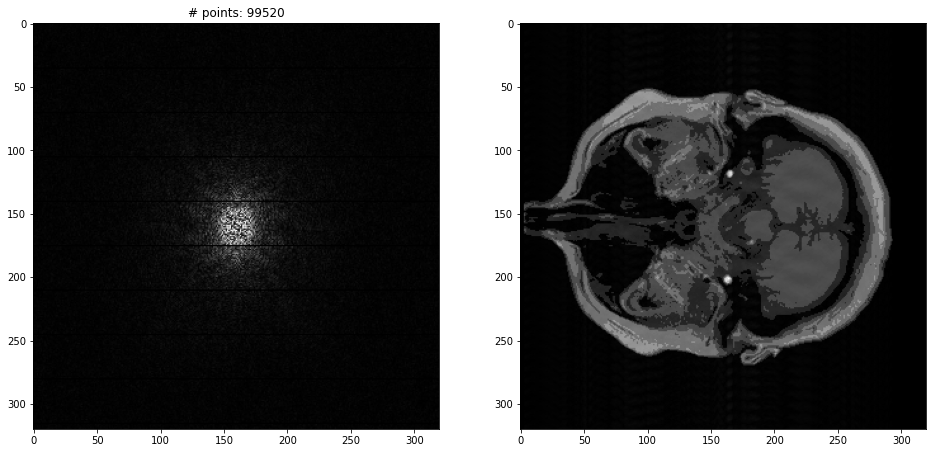

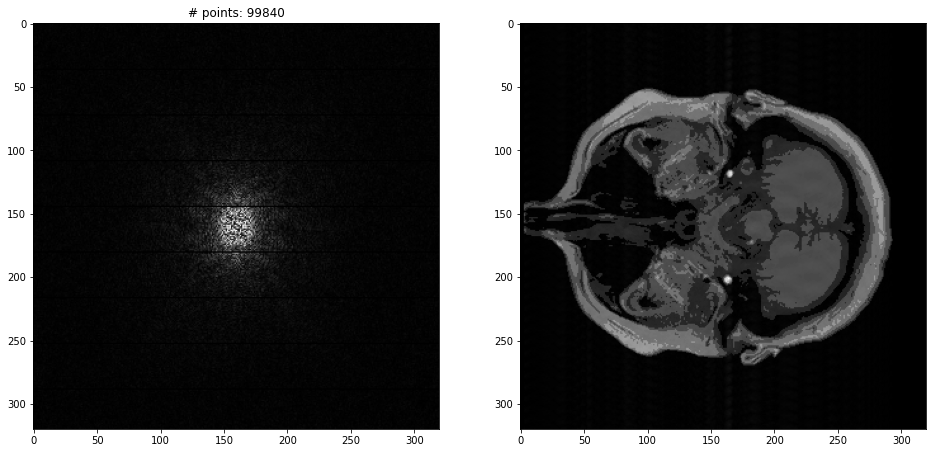

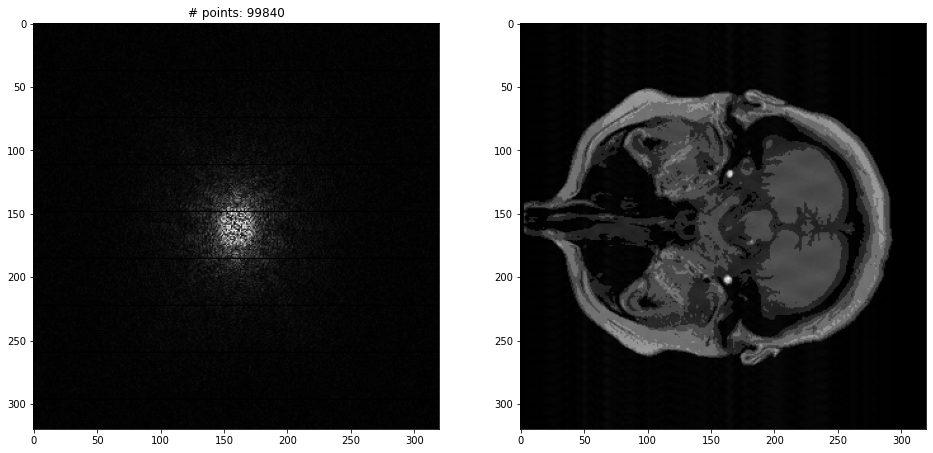

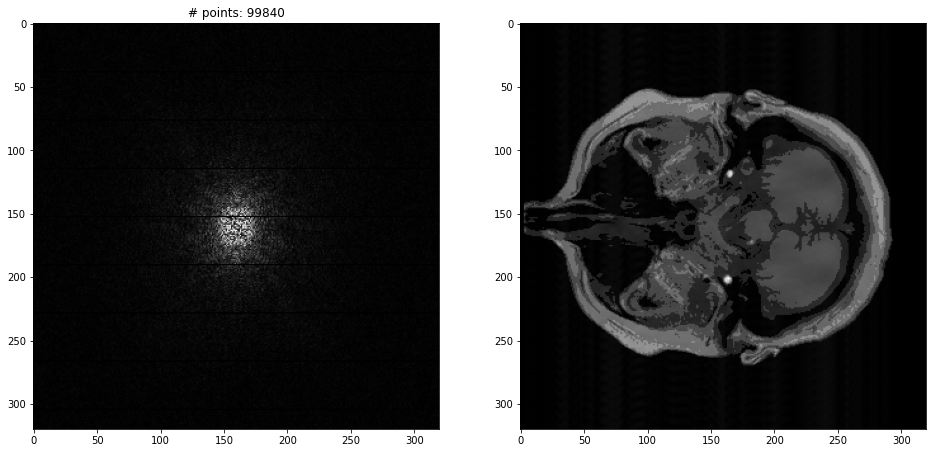

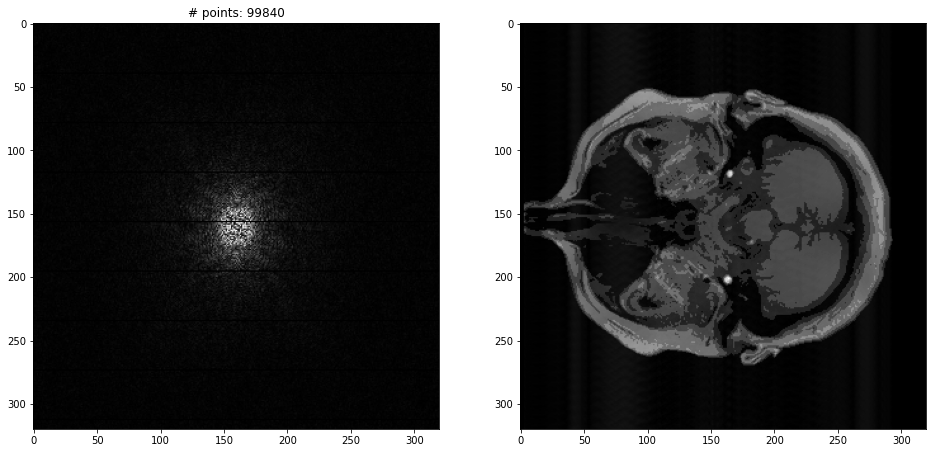

In [234]:
get_plots_inverse_ft(t1_dict['mag'], t1_dict['ang'], horizontal_mask, 'horizontal_mask_idft_pairs')

## t2

In [218]:
t2_dict = dft_data_dict['t2']

In [214]:
#get_plots_inverse_ft(t2_dict['mag'], t2_dict['ang'], circular_mask, 'circular_mask_idft_pairs')

In [224]:
#get_plots_inverse_ft(t2_dict['mag'], t2_dict['ang'], random_mask, 'random_mask_idft_pairs')

In [223]:
#get_plots_inverse_ft(t2_dict['mag'], t2_dict['ang'], vertical_mask, 'vertical_mask_idft_pairs')

In [222]:
#get_plots_inverse_ft(t2_dict['mag'], t2_dict['ang'], horizontal_mask, 'horizontal_mask_idft_pairs')

current model is at a slice level
dataset - emulateed from a single coil - use full k-space data from all the coils
read papers - youtube + otherpapers - how to get k-space info

download fast mri knee/brain dataset
understand the dataset - how many coils, multi-coil to single coils - what is the coil doing - data acquisition
form a problem in a few weeks

## convolution in frequency space

- pad the convolution kernel to the size of k-space
- take DFT padded kernel
- multiply padded kernel with k-space elementwise
- Take Inverse DFT to get back to spatial domain

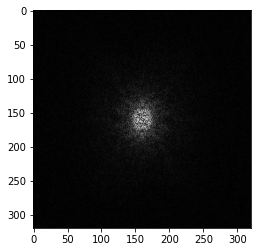

In [13]:
plt.imshow(dft_data_dict['t1']['mag'], cmap='gray')

In [3]:
import torchvision
import torchvision.transforms as T

In [16]:
kspace = dft_data_dict['t1']['mag']

In [17]:
kspace = T.ToTensor()(kspace)
kspace = kspace.unsqueeze(0)
kspace.shape

torch.Size([1, 1, 320, 320])

In [21]:
conv = torch.nn.Conv2d(1, 1, 5)

In [26]:
conv

Conv2d(1, 1, kernel_size=(5, 5), stride=(1, 1))